<a href="https://colab.research.google.com/github/fx-manmeet/learn-ml-repo/blob/main/character_wise_ocr.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!sudo apt install tesseract-ocr

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 45 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 6s (861 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debcon

In [ ]:
!pip install pytesseract


In [ ]:
from google.colab.patches import cv2_imshow

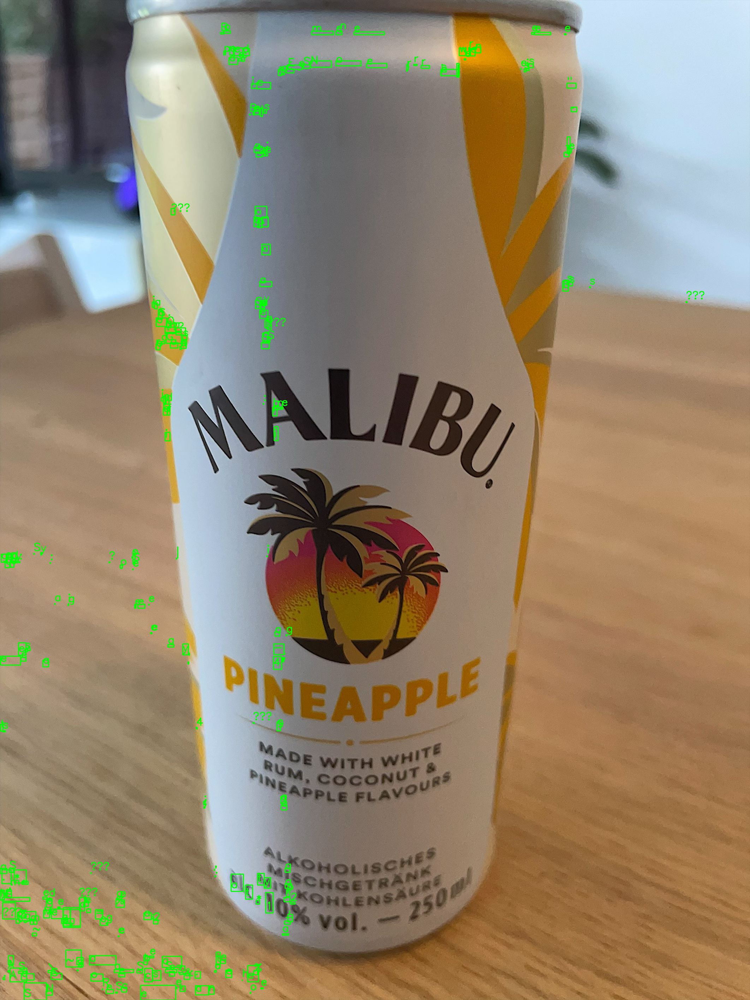

Character: B
Bounding Box (x, y, w, h): (624, 2736, 632, 2741)
Character: o
Bounding Box (x, y, w, h): (634, 2738, 652, 2745)
Character: m
Bounding Box (x, y, w, h): (882, 2734, 944, 2744)
Character: e
Bounding Box (x, y, w, h): (951, 2734, 968, 2744)
Character: n
Bounding Box (x, y, w, h): (962, 2741, 964, 2743)
Character: e
Bounding Box (x, y, w, h): (1002, 2734, 1088, 2742)
Character: e
Bounding Box (x, y, w, h): (1505, 2735, 1512, 2741)
Character: e
Bounding Box (x, y, w, h): (1514, 2734, 1559, 2741)
Character: e
Bounding Box (x, y, w, h): (1598, 2734, 1603, 2737)
Character: p
Bounding Box (x, y, w, h): (633, 2677, 638, 2688)
Character: e
Bounding Box (x, y, w, h): (650, 2677, 661, 2700)
Character: e
Bounding Box (x, y, w, h): (663, 2675, 687, 2697)
Character: d
Bounding Box (x, y, w, h): (687, 2675, 706, 2695)
Character: w
Bounding Box (x, y, w, h): (1300, 2675, 1319, 2696)
Character: r
Bounding Box (x, y, w, h): (1327, 2690, 1330, 2698)
Character: e
Bounding Box (x, y, w, h): (13

In [ ]:
import cv2
import pytesseract

# Path to the image containing multiple characters
image_path = "/content/drive/MyDrive/OCR_Cardbord_images/1708520932181342.jpg"

# Read the image
image = cv2.imread(image_path)

# Perform OCR using pytesseract
custom_config = r'--oem 3 --psm 6'  # Page segmentation mode 6 treats the image as a single uniform block of text
text = pytesseract.image_to_boxes(image, config=custom_config)

# Parse the output to get individual characters and their bounding boxes
character_boxes = []
for line in text.splitlines():
    character_info = line.split()
    character = character_info[0]
    x, y, w, h = map(int, character_info[1:5])
    character_boxes.append((character, (x, y, w, h)))

# Draw bounding boxes on the image
for char, (x, y, w, h) in character_boxes:
    cv2.rectangle(image, (x, image.shape[0] - y), (w, image.shape[0] - h), (0, 255, 0), 2)  # Adjust y-coordinate to match OpenCV's coordinate system
    cv2.putText(image, char, (x, image.shape[0] - y - 10), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)  # Adjust y-coordinate for text position

# Display the image with bounding boxes
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Print individual characters and their bounding boxes
for char, (x, y, w, h) in character_boxes:
    print("Character:", char)
    print("Bounding Box (x, y, w, h):", (x, y, w, h))


In [ ]:
/content/drive/MyDrive/OCR_Cardbord_images/1708520932181342.jpg

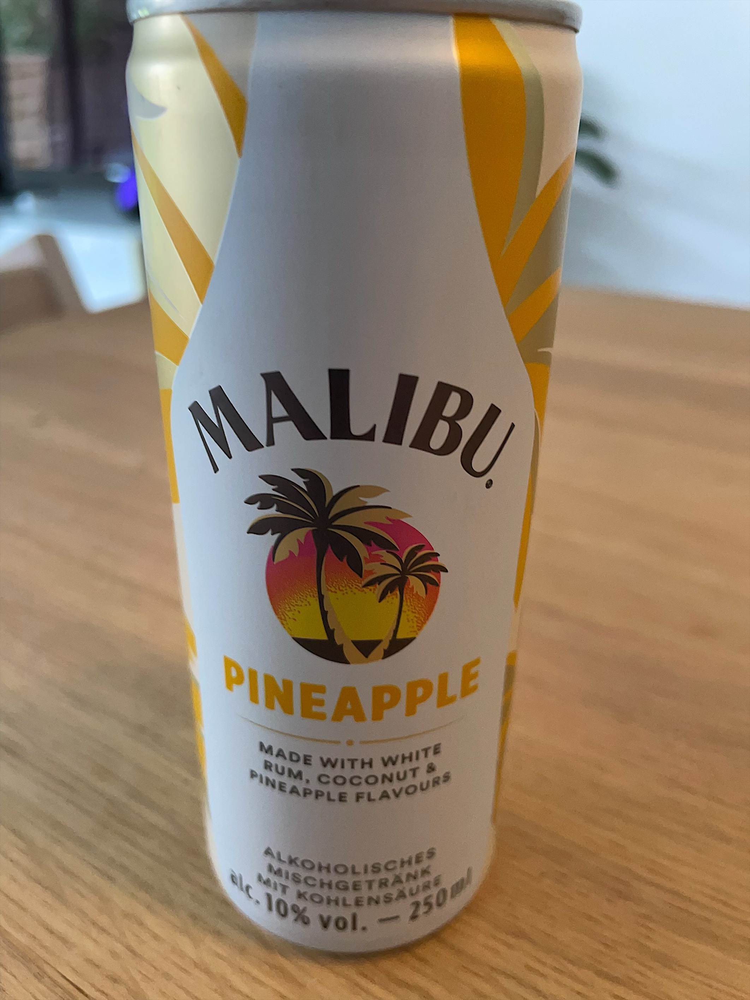

In [ ]:
import cv2
import pytesseract
import numpy as np

# Load the image
image = cv2.imread('/content/drive/MyDrive/OCR_Cardbord_images/1708520932181342.jpg')
original_image = image.copy()

# Get the character-level data
data = pytesseract.image_to_data(image, output_type=pytesseract.Output.DICT)

# Extract characters and bounding boxes
for i in range(len(data['text'])):
    if data['text'][i].strip():
        char = data['text'][i]
        x, y, w, h = data['left'][i], data['top'][i], data['width'][i], data['height'][i]
        bbox = (x, y, x + w, y + h)
        print(f"Character: {char}, Bounding Box: {bbox}")
        cv2.rectangle(original_image, (x, y), (x + w, y + h), (0, 255, 0), 2)

# Display the image with bounding boxes
cv2_imshow(original_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
!pip install easyocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 32.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 908.3/908.3 kB 56.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 34.8 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manyl

In [ ]:
import easyocr
import cv2
import numpy as np

# Load the pre-trained model
reader = easyocr.Reader(['en'])

# Load the image
image = cv2.imread('/content/drive/MyDrive/OCR_Cardbord_images/1708520932181342.jpg')
original_image = image.copy()

# Detect characters and bounding boxes
results = reader.readtext('/content/drive/MyDrive/OCR_Cardbord_images/1708520932181342.jpg', detail=1)

# Print the results and draw bounding boxes
for result in results:
    char, bbox = result[1], result[0]
    print(f"Character: {char}, Bounding Box: {bbox}")
    x1, y1, x2, y2 = bbox  # Unpack the bounding box coordinates
    top_left = (x1, y1)  # Top-left corner
    bottom_right = (x2, y2)  # Bottom-right corner
    cv2.rectangle(original_image, top_left, bottom_right, (0, 255, 0), 2)

# Display the image with bounding boxes
cv2_imshow(original_image)
cv2.waitKey(0)
cv2.destroyAllWindows()


Character: MALIBU, Bounding Box: [[503, 978], [1497, 978], [1497, 1399], [503, 1399]]


error: OpenCV(4.8.0) :-1: error: (-5:Bad argument) in function 'rectangle'
> Overload resolution failed:
>  - Can't parse 'pt1'. Sequence item with index 0 has a wrong type
>  - Can't parse 'pt1'. Sequence item with index 0 has a wrong type
>  - Can't parse 'rec'. Expected sequence length 4, got 2
>  - Can't parse 'rec'. Expected sequence length 4, got 2


In [ ]:
!pip install craft_text_detector

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.3/60.3 MB 12.5 MB/s eta 0:00:00
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.8.0.76
    Uninstalling opencv-python-4.8.0.76:
      Successfully uninstalled opencv-python-4.8.0.76


In [ ]:
!pip install --upgrade torch torchvision

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 779.1/779.1 MB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 72.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 168.1/168.1 MB 7.5 MB/s eta 0:00:00
  Attempting uninstall: triton
    Found existing installation: triton 2.3.0
    Uninstalling triton-2.3.0:
      Successfully uninstalled triton-2.3.0
  Attempting uninstall: torch
    Found existing installation: torch 2.3.0+cu121
    Uninstalling torch-2.3.0+cu121:
      Successfully uninstalled torch-2.3.0+cu121
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.18.0+cu121
    Uninstalling torchvision-0.18.0+cu121:
      Successfully uninstalled torchvision-0.18.0+cu121
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchaudio 2.3.0+cu121 requires torch==2.3.0, but you have torch 2.3.1 

In [ ]:
model_urls = {
    'vgg16': 'https://download.pytorch.org/models/vgg16-397923af.pth',
    'vgg16_bn': 'https://download.pytorch.org/models/vgg16_bn-6c64b313.pth',
    # Add more URLs if needed
}

In [ ]:
import cv2
from craft_text_detector import Craft
import numpy as np

# Load the pre-trained model
detector = Craft(crop_type="poly", cuda=False)

# Load the image
image = cv2.imread('/content/drive/MyDrive/OCR_Cardbord_images/1708520932181342.jpg')
original_image = image.copy()

# Detect characters and bounding boxes
prediction = detector.detect_and_crop_text(image)

# Print the results and draw bounding boxes
for bbox, char in zip(prediction['bboxes'], prediction['text']):
    print(f"Character: {char}, Bounding Box: {bbox}")
    x1, y1, x2, y2 = bbox[0][0], bbox[0][1], bbox[2][0], bbox[2][1]
    cv2.rectangle(original_image, (x1, y1), (x2, y2), (0, 255, 0), 2)

# Display the image with bounding boxes
cv2.imshow('Image with Bounding Boxes', original_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

ImportError: cannot import name 'model_urls' from 'torchvision.models.vgg' (/usr/local/lib/python3.10/dist-packages/torchvision/models/vgg.py)

In [ ]:
# importing cv2 & numpy:
import numpy as np
import cv2

# Set image path
path = "/content/drive/MyDrive/OCR_Cardbord_images/"
fileName = "1708520932181342.jpg"

# Read input image:
inputImage = cv2.imread(path+fileName)
inputCopy = inputImage.copy()

# Convert BGR to grayscale:
grayscaleImage = cv2.cvtColor(inputImage, cv2.COLOR_BGR2GRAY)

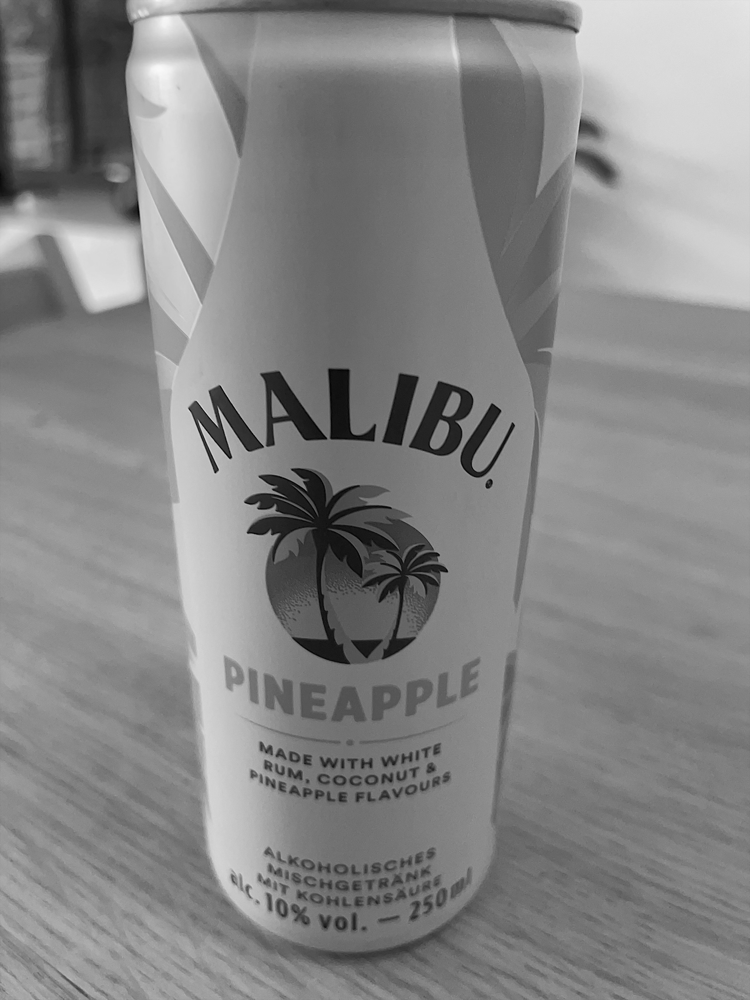

In [ ]:
cv2_imshow(grayscaleImage)

In [ ]:
# Set the adaptive thresholding (gasussian) parameters:
windowSize = 31
windowConstant = -1
# Apply the threshold:
binaryImage = cv2.adaptiveThreshold(grayscaleImage, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, windowSize, windowConstant)

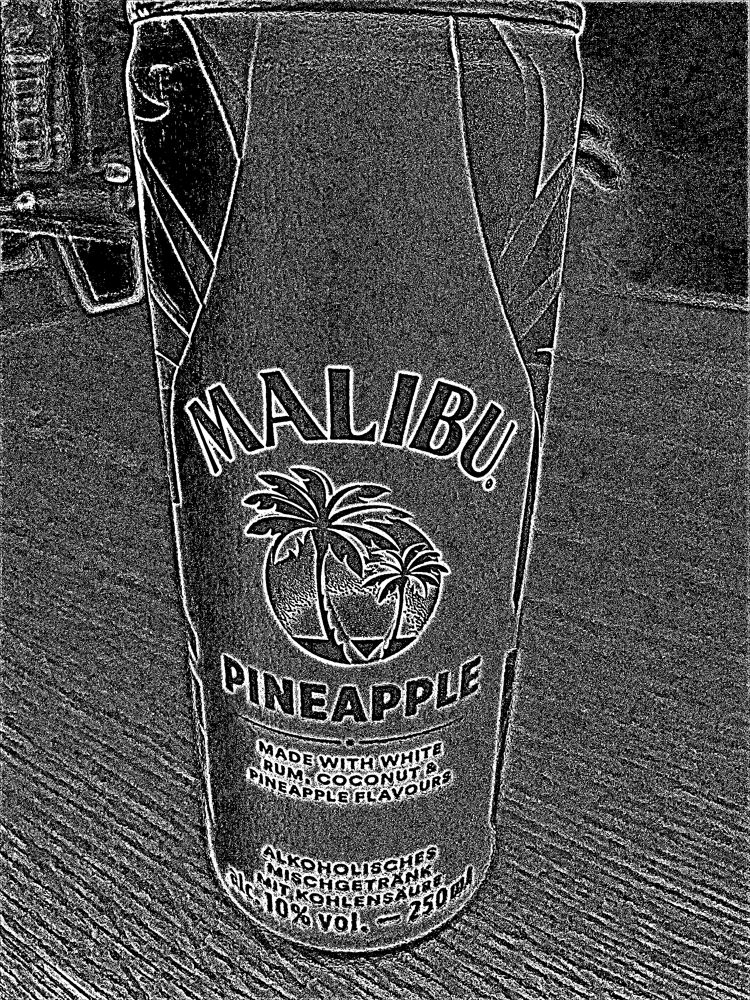

In [ ]:
cv2_imshow(binaryImage)

In [ ]:
# Perform an area filter on the binary blobs:
componentsNumber, labeledImage, componentStats, componentCentroids = \
cv2.connectedComponentsWithStats(binaryImage, connectivity=4)

# Set the minimum pixels for the area filter:
minArea = 20

# Get the indices/labels of the remaining components based on the area stat
# (skip the background component at index 0)
remainingComponentLabels = [i for i in range(1, componentsNumber) if componentStats[i][4] >= minArea]

# Filter the labeled pixels based on the remaining labels,
# assign pixel intensity to 255 (uint8) for the remaining pixels
filteredImage = np.where(np.isin(labeledImage, remainingComponentLabels) == True, 255, 0).astype('uint8')

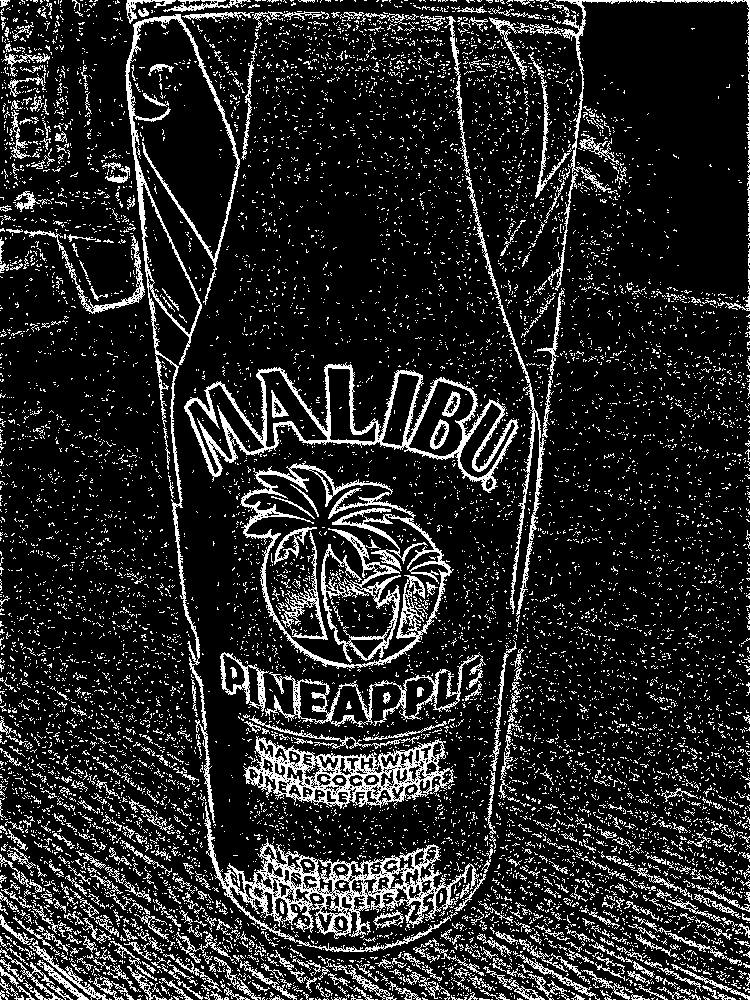

In [ ]:
cv2_imshow(filteredImage)

In [ ]:
# Set kernel (structuring element) size:
kernelSize = 3

# Set operation iterations:
opIterations = 1

# Get the structuring element:
maxKernel = cv2.getStructuringElement(cv2.MORPH_RECT, (kernelSize, kernelSize))

# Perform closing:
closingImage = cv2.morphologyEx(filteredImage, cv2.MORPH_CLOSE, maxKernel, None, None, opIterations, cv2.BORDER_REFLECT101)

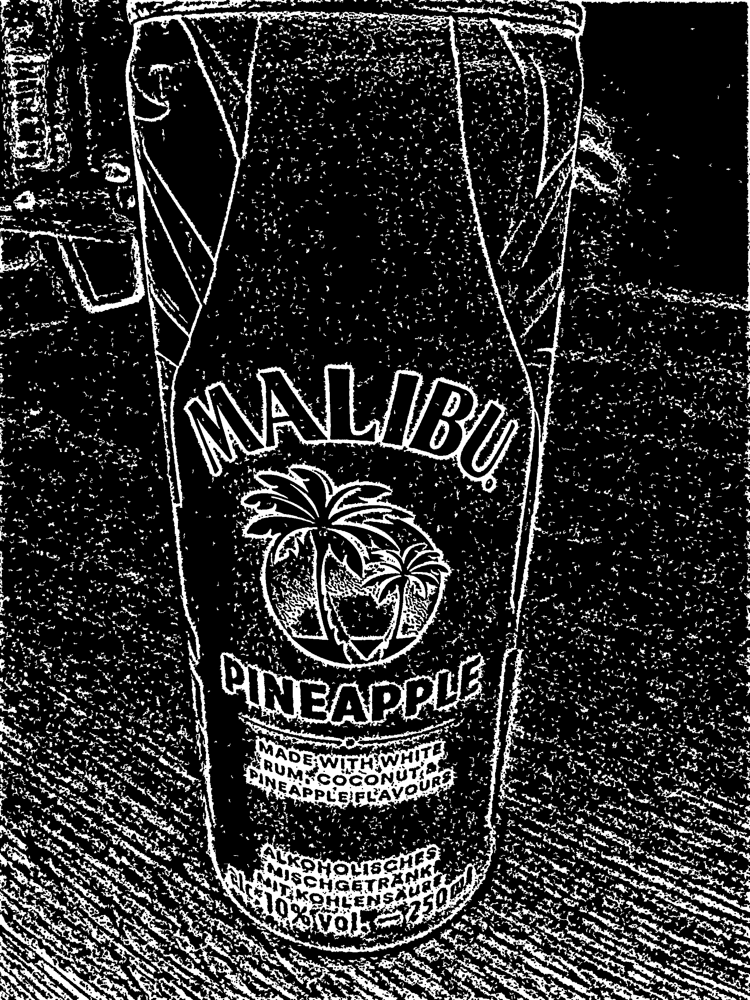

In [ ]:
cv2_imshow(closingImage)

In [ ]:
preprossed_image_path = 'thresholded_image.jpg'
cv2.imwrite(preprossed_image_path, closingImage)

True

In [ ]:
!pip install python-doctr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 29.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.5/981.5 kB 42.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 64.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.9/289.9 kB 26.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 12.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 235.5/235.5 kB 25.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 85.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 71.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 848.9/8

In [ ]:
!pip install tf2onnx        #1.16.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.8/455.8 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 41.6 MB/s eta 0:00:00


In [ ]:
from doctr.models import ocr_predictor

model = ocr_predictor(det_arch='db_resnet50', reco_arch='crnn_vgg16_bn', pretrained=True)

  0%|          | 0/94122142 [00:00<?, ?it/s]

  0%|          | 0/58758994 [00:00<?, ?it/s]

In [ ]:
from doctr.io import DocumentFile

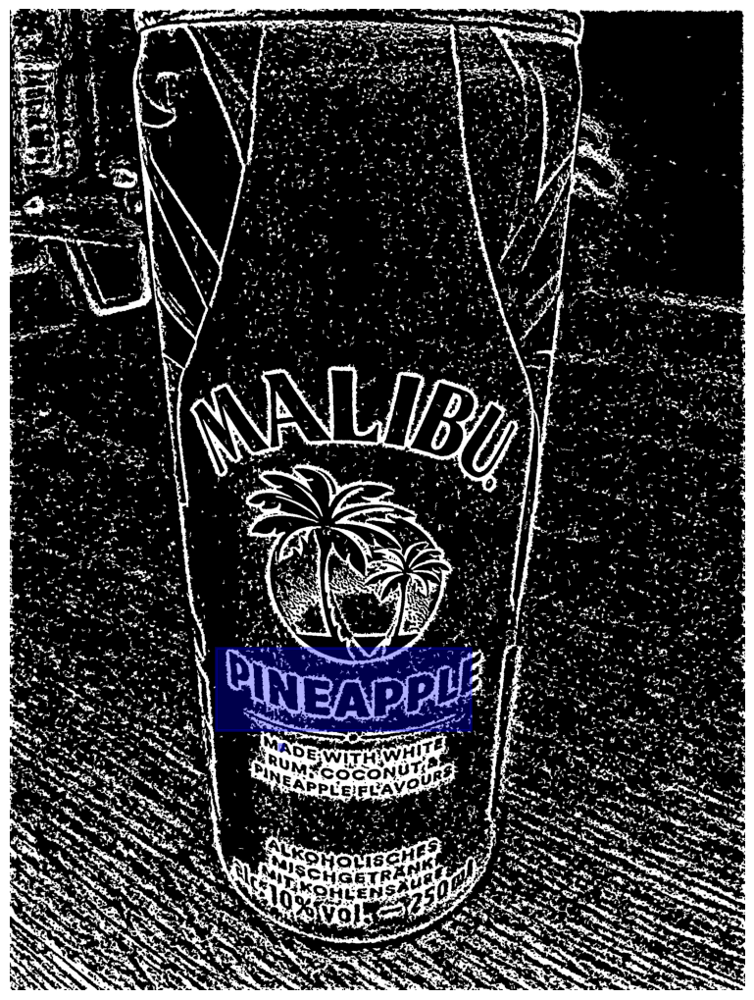

In [ ]:
single_img_doc = DocumentFile.from_images(preprossed_image_path)
result = model(single_img_doc)
result.show()

In [ ]:
!pip install pyocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.0/40.0 kB 2.2 MB/s eta 0:00:00


In [ ]:
# Set the OCR libraries:
from PIL import Image
import pyocr
import pyocr.builders

# Set pyocr tools:
tools = pyocr.get_available_tools()
# The tools are returned in the recommended order of usage
tool = tools[0]

# Set OCR language:
langs = tool.get_available_languages()
lang = langs[0]

# Get string from image:
txt = tool.image_to_string(
    Image.open("/content/thresholded_image.jpg"),
    lang=lang,
    builder=pyocr.builders.TextBuilder()
)

print("Text is:"+txt)

Text is:


In [ ]:
# Get each bounding box
# Find the big contours/blobs on the filtered image:
contours, hierarchy = cv2.findContours(closingImage, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

contours_poly = [None] * len(contours)
# The Bounding Rectangles will be stored here:
boundRect = []

# Alright, just look for the outer bounding boxes:
for i, c in enumerate(contours):

    if hierarchy[0][i][3] == -1:
        contours_poly[i] = cv2.approxPolyDP(c, 3, True)
        boundRect.append(cv2.boundingRect(contours_poly[i]))


# Draw the bounding boxes on the (copied) input image:
for i in range(len(boundRect)):
    color = (0, 255, 0)
    cv2.rectangle(inputCopy, (int(boundRect[i][0]), int(boundRect[i][1])), \
              (int(boundRect[i][0] + boundRect[i][2]), int(boundRect[i][1] + boundRect[i][3])), color, 2)

In [ ]:
from google.colab.patches import cv2_imshow

In [ ]:
cv2_imshow(closingImage)

NameError: name 'closingImage' is not defined

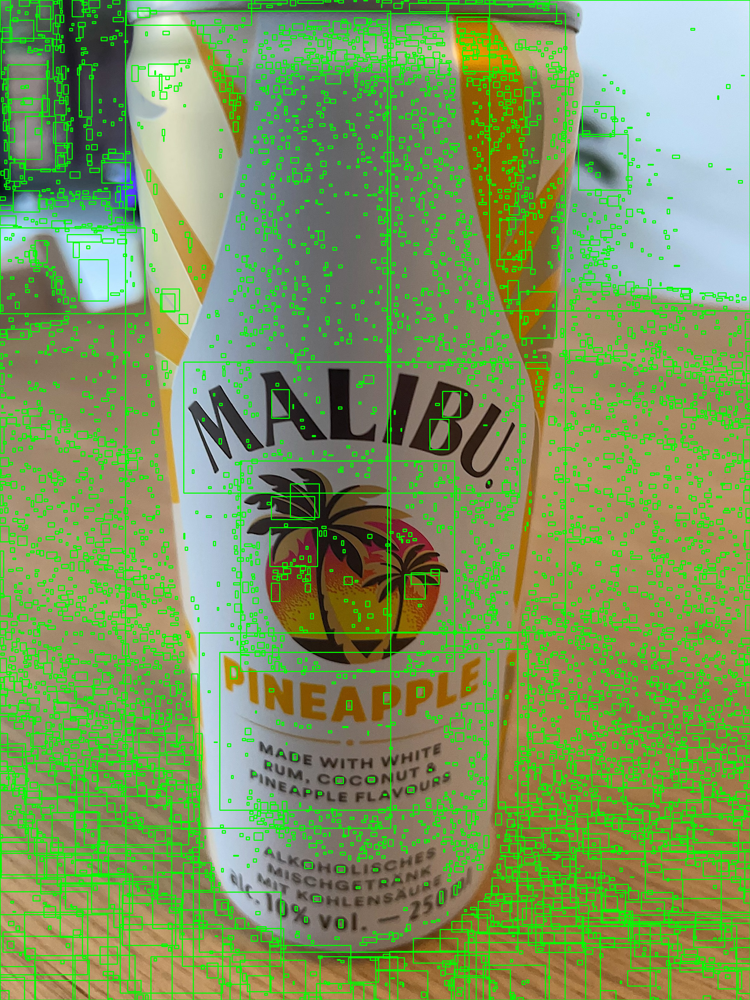

In [ ]:
cv2_imshow(inputCopy)

In [ ]:
#paddle ocr

(2832, 2124)


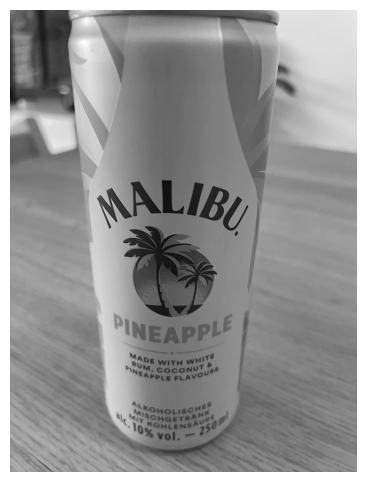

(2832, 2124)


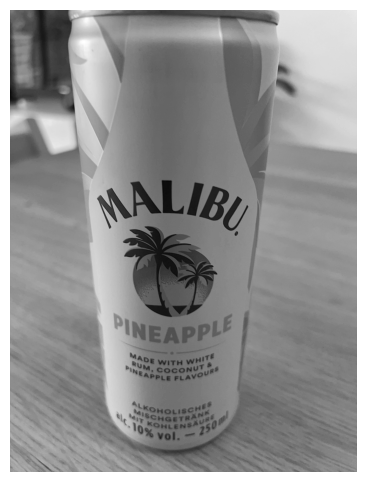

(2832, 2124)


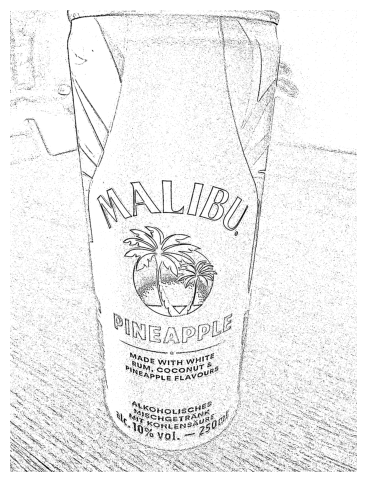

(2832, 2124)


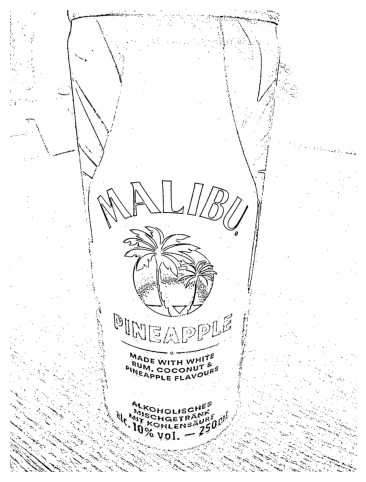

(2832, 2124)


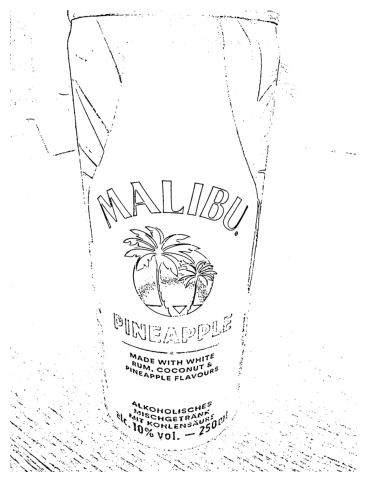

(2832, 2124)


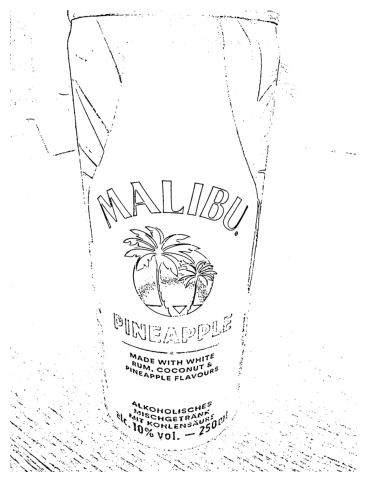

In [ ]:
#pipeline for ocr
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Function to display and save images
def display_and_save_image(image, title, filename):
    print(image.shape)
    cv2.imwrite(filename, image)
    plt.figure(figsize=(6, 6))
    plt.imshow(image, cmap='gray')
    #plt.title(title)
    plt.axis('off')
    #plt.savefig(filename)
    plt.show()

# Blurring function
def apply_blur(image):
    blurred = cv2.GaussianBlur(image, (5, 5), 0)
    display_and_save_image(blurred, 'Blurred Image', 'blurred_image.png')
    return blurred

# Thresholding function
def apply_threshold(image):
    thresholded = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY, 11, 2)
    display_and_save_image(thresholded, 'Thresholded Image', 'thresholded_image.png')
    return thresholded


# Morphological operations function
def apply_morphological_operations(image):
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    opening = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel)
    display_and_save_image(closing, 'Morphological Operations Applied Image', 'morphed_image.png')
    return closing

# Noise removal function
def remove_noise(image):
    noise_removed = cv2.medianBlur(image, 5)
    display_and_save_image(noise_removed, 'Noise Removed Image', 'noise_removed_image.png')
    return noise_removed

# Complete preprocessing pipeline
def preprocess_image_for_ocr(image_path):
    # Load the image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    display_and_save_image(image, 'Original Image', 'original_image.png')

    # Apply blurring
    blurred_image = apply_blur(image)

    # Apply thresholding
    thresholded_image = apply_threshold(blurred_image)

    # Apply morphological operations (opening and closing)
    morphed_image = apply_morphological_operations(thresholded_image)

    # Remove noise
    final_image = remove_noise(morphed_image)

    display_and_save_image(final_image, 'Final Preprocessed Image', 'final_image.png')
    return final_image

# Example usage:
preprocessed_image = preprocess_image_for_ocr('/content/drive/MyDrive/OCR_Cardbord_images/1708520932181342.jpg')


In [ ]:
!pip install pytesseract
!sudo apt install tesseract-ocr

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 45 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 46s (104 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debco

2832 2124


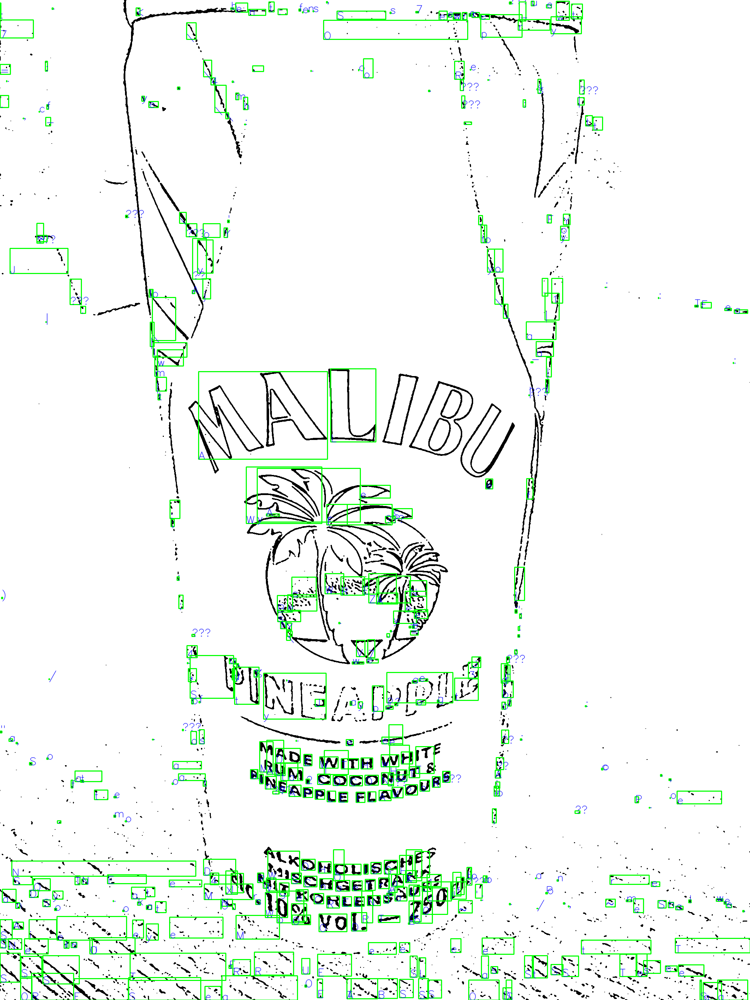

In [ ]:
#
import cv2
import pytesseract

# Path to the Tesseract executable
pytesseract.pytesseract.tesseract_cmd = r'/usr/bin/tesseract'

def preprocess_image(image):
    # Convert image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # Apply Gaussian blur to remove noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    # Apply adaptive thresholding to binarize the image
    thresholded = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11, 4)
    return thresholded

def detect_and_draw_boxes(image):
    hi, wi,_ = image.shape
    print(hi,wi)
    conf='--psm 6 --oem 1 -l eng'
    boxes = pytesseract.image_to_boxes(image, config=conf)

    # Plot bounding boxes around individual characters
    for b in boxes.splitlines():
        b = b.split()
        char = b[0]
        x, y, w, h = map(int, b[1:5])
        cv2.rectangle(image, (x, hi-y), (w, hi-h), (0, 255, 0), 2)
        cv2.putText(image, char, (x, hi - y), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 1, cv2.LINE_AA)

    return image

# Load image using OpenCV
image = cv2.imread('/content/noise_removed_image.png')

# Preprocess image
#processed_image = preprocess_image(image)

# Draw bounding boxes around characters
image_with_boxes = detect_and_draw_boxes(image)

# Display image with bounding boxes
cv2_imshow( image_with_boxes)
cv2.waitKey(0)
cv2.destroyAllWindows()


In [1]:
#trying keras-ocr

!pip install keras-ocr numpy matplotlib opencv-python


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.3/42.3 kB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.5/9.5 MB 47.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 908.3/908.3 kB 45.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.0/40.0 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 4.4 MB/s eta 0:00:00


In [2]:
import matplotlib.pyplot as plt
import keras_ocr
import cv2


In [3]:
pipeline = keras_ocr.pipeline.Pipeline()


Looking for /root/.keras-ocr/craft_mlt_25k.h5


Instructions for updating:
Use `tf.image.resize(...method=ResizeMethod.BILINEAR...)` instead.


Looking for /root/.keras-ocr/crnn_kurapan.h5


(2832, 2124)


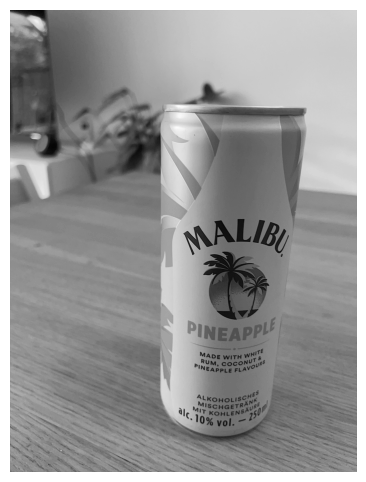

(2832, 2124)


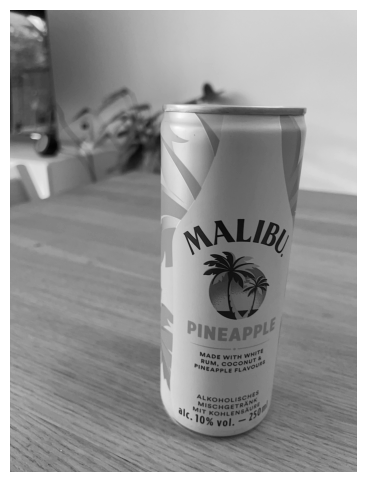

(2832, 2124)


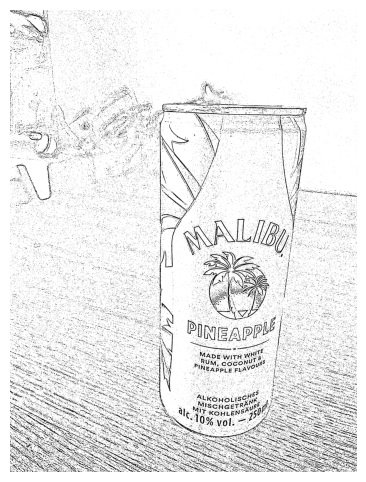

(2832, 2124)


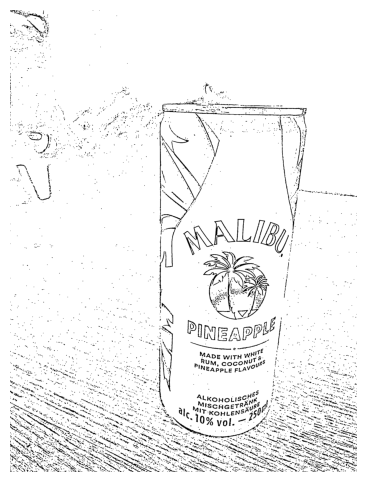

(2832, 2124)


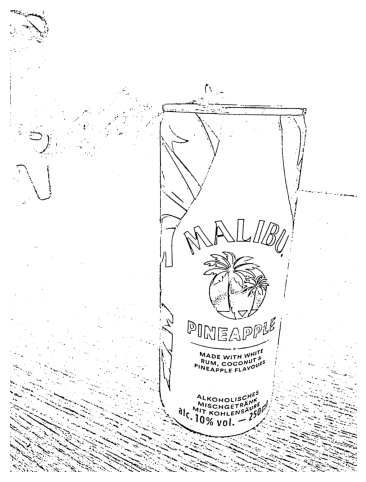

(2832, 2124)


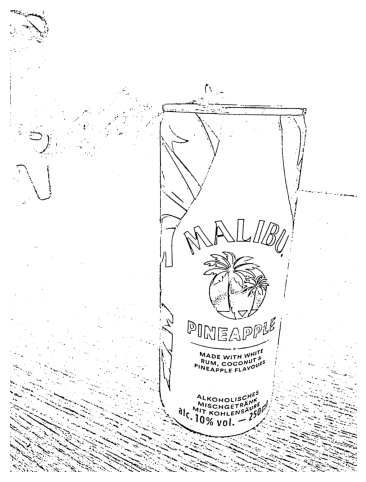

In [20]:
#pipeline for ocr
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Function to display and save images
def display_and_save_image(image, title, filename):
    print(image.shape)
    cv2.imwrite(filename, image)
    plt.figure(figsize=(6, 6))
    plt.imshow(image, cmap='gray')
    #plt.title(title)
    plt.axis('off')
    #plt.savefig(filename)
    plt.show()

# Blurring function
def apply_blur(image):
    blurred = cv2.GaussianBlur(image, (5, 5), 0)
    display_and_save_image(blurred, 'Blurred Image', 'blurred_image.png')
    return blurred

# Thresholding function
def apply_threshold(image):
    thresholded = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY, 11, 2)
    display_and_save_image(thresholded, 'Thresholded Image', 'thresholded_image.png')
    return thresholded


# Morphological operations function
def apply_morphological_operations(image):
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    opening = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel)
    display_and_save_image(closing, 'Morphological Operations Applied Image', 'morphed_image.png')
    return closing

# Noise removal function
def remove_noise(image):
    noise_removed = cv2.medianBlur(image, 5)
    display_and_save_image(noise_removed, 'Noise Removed Image', 'noise_removed_image.png')
    return noise_removed

# Complete preprocessing pipeline
def preprocess_image_for_ocr(image_path):
    # Load the image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    display_and_save_image(image, 'Original Image', 'original_image.png')

    # Apply blurring
    blurred_image = apply_blur(image)

    # Apply thresholding
    thresholded_image = apply_threshold(blurred_image)

    # Apply morphological operations (opening and closing)
    morphed_image = apply_morphological_operations(thresholded_image)

    # Remove noise
    final_image = remove_noise(morphed_image)

    display_and_save_image(final_image, 'Final Preprocessed Image', 'final_image.png')
    return final_image

# Example usage:
preprocessed_image = preprocess_image_for_ocr('/content/drive/MyDrive/OCR_Cardbord_images/1708520936786255.jpg')


In [21]:
image_path = '/content/final_image.png'
image = keras_ocr.tools.read(image_path)


In [22]:
predictions = pipeline.recognize([image])


1/1 [==============================] - 5s 5s/step


###Trying with keras ocr preprocessed.

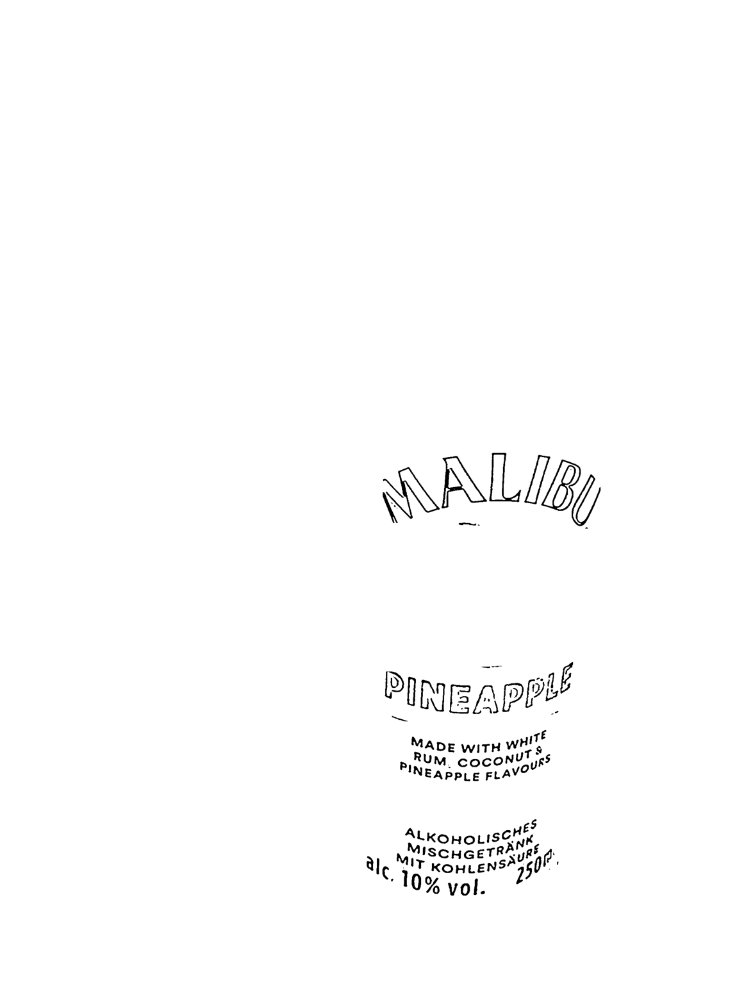

In [23]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20, 20))

# Ensure axs is always a list for consistent iteration
axs = [ax]

# Iterate over the predictions
for ax, image, prediction in zip(axs, [image], predictions):
    masked_image = np.ones_like(image) * 255  # Start with a white image
    for word, box in prediction:
        # Create a mask for the bounding box
        mask = np.zeros_like(image, dtype=np.uint8)
        polygon = np.array([box], dtype=np.int32)
        cv2.fillPoly(mask, polygon, (255, 255, 255))

        # Apply the mask to the image (keeping only the region inside the polygon)
        masked_image = np.where(mask == 255, image, masked_image)

    # Convert the masked image to a PIL Image and save it
    imagez = Image.fromarray(masked_image)
    imagez.save('saved_image.png')

    # Display the masked image
    ax.imshow(masked_image)
    ax.axis('off')  # Hide the axis

plt.show()

In [ ]:
import keras_ocr
import cv2
import numpy as np

# Initialize the keras_ocr pipeline
pipeline = keras_ocr.pipeline.Pipeline()

# Load your image
image = cv2.imread('/content/final_image.png')

# Use the keras_ocr pipeline to detect and recognize text
predictions = pipeline.recognize([image])

# Loop through the predicted text and draw bounding boxes for individual characters


Looking for /root/.keras-ocr/craft_mlt_25k.h5


KeyboardInterrupt: 

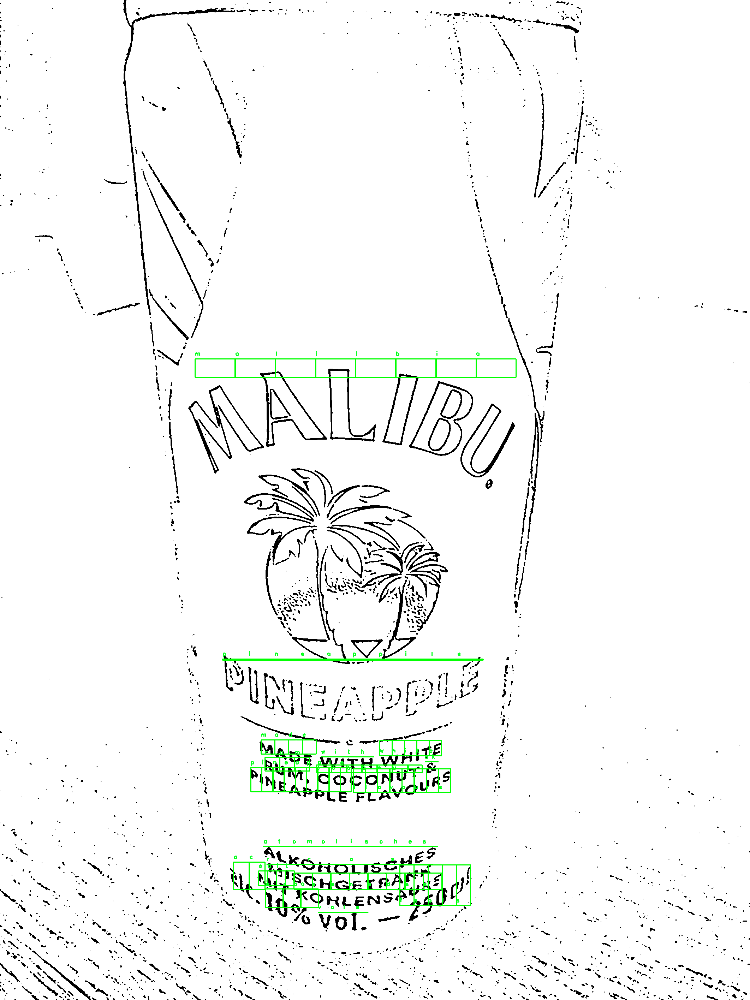

In [ ]:
for prediction in predictions[0]:
    box = prediction[1]
    text = prediction[0]

    # Split the text into individual characters
    for i, char in enumerate(text):
        # Calculate the bounding box for the individual character
        char_width = (box[1][0] - box[0][0]) / len(text)
        x1 = int(box[0][0] + i * char_width)
        y1 = int(box[0][1])
        x2 = int(x1 + char_width)
        y2 = int(box[1][1])

        # Draw the bounding box for the individual character
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Draw the character text
        cv2.putText(image, char, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (36, 255, 12), 2)

# Display or save the image with bounding boxes
cv2_imshow(image)

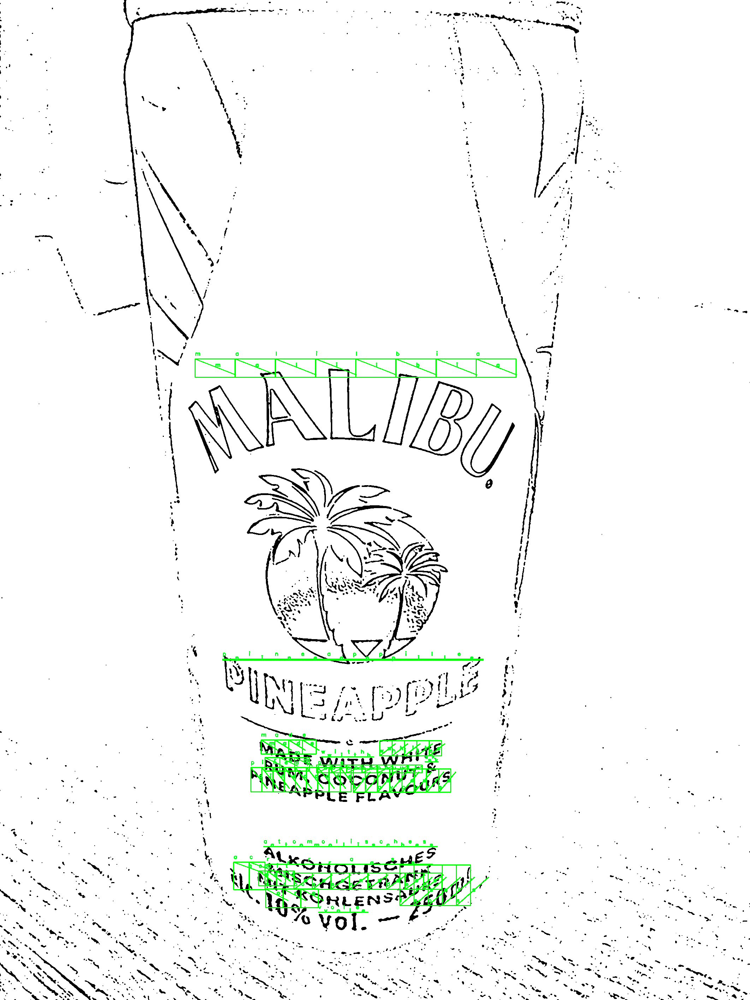

In [ ]:
import math
for prediction in predictions[0]:
    box = np.array(prediction[1])
    text = prediction[0]

    # Calculate the rotation angle of the text region
    angle = np.arctan2(box[1, 1] - box[0, 1], box[1, 0] - box[0, 0]) * 180 / np.pi

    # Split the text into individual characters
    for i, char in enumerate(text):
        # Calculate the bounding box for the individual character
        char_width = (box[1][0] - box[0][0]) / len(text)
        x1 = int(box[0][0] + i * char_width)
        y1 = int(box[0][1])
        x2 = int(x1 + char_width)
        y2 = int(box[1][1])
        char_box = np.array([[x1, y1], [x2, y2]])

        # Rotate the bounding box according to the text region's angle
        M = cv2.getRotationMatrix2D((x1, y1), angle, 1)
        rotated_box = np.dot(char_box - np.array([[x1, y1]]), M[:2, :2].T) + np.array([[x1, y1]])

        # Draw the rotated bounding box for the individual character
        cv2.polylines(image, [np.int32(rotated_box)], True, (0, 255, 0), 2)

        # Draw the character text
        text_angle = math.atan2(rotated_box[1, 1] - rotated_box[0, 1], rotated_box[1, 0] - rotated_box[0, 0]) * 180 / np.pi
        text_x = int((rotated_box[0, 0] + rotated_box[1, 0]) / 2)
        text_y = int((rotated_box[0, 1] + rotated_box[1, 1]) / 2)
        cv2.putText(image, char, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (36, 255, 12), 2, cv2.LINE_AA)

# Display or save the image with bounding boxes
cv2_imshow( image)

In [7]:
from PIL import Image